In [91]:
import jax
jax.config.update("jax_enable_x64", True)
import numpy as np
import jax.numpy as jnp

import matplotlib.pyplot as plt
import matplotlib as mpl

mpl.rcParams['text.usetex'] = True
mpl.rcParams['font.size'] = 10
mpl.rcParams['axes.grid'] = True
mpl.rcParams['axes.xmargin'] = 0
mpl.rcParams['lines.linewidth'] = 2
mpl.rcParams['legend.frameon'] = False
mpl.rcParams['savefig.bbox'] = 'tight'

import jaxsp as jsp

from scipy import constants as const

import matplotlib.animation as animation
from IPython.display import HTML

import Stellar_sim_funcs as SSF
import importlib
importlib.reload(SSF)


from scipy.interpolate import interp1d

from collections import defaultdict

from jaxsp.constants import h, om, hbar, Msun, GN, c, m22

G = GN.value * (u.from_cm**3) / (u.from_g * u.from_s**2)


In [54]:
m22 = 1
u = jsp.set_schroedinger_units(m22)

In [55]:
rho = jax.vmap(jsp.rho, in_axes=(0,None))

# rho is a function we can input array r and parameter values to get the density

In [56]:
cNFWtides_params = jnp.array([
    357964808.148399 * u.from_Msun, 
    25.690207, 
    0.407461, 
    0.012670 * u.from_Kpc, 
    1.857991 * u.from_Kpc, 
    3.729259
])
density_params = jsp.init_core_NFW_tides_params_from_sample(cNFWtides_params)
r99 = jsp.enclosing_radius(0.99, density_params) # radius that encloses 99% of mass
print(r99)
density_params

20.743367613524313


core_NFW_tides_params:
	name=236146193804778771,
	M200=1118.7951678146808,
	c=25.690207,
	n=0.407461,
	rc=0.0005960840778498662,
	rt=0.0874126954923718,
	delta=3.729259,
    Derived:
	rs=0.026822448297135815,
	g=0.4307070628318999,
	rho0=1987135.4034031027,

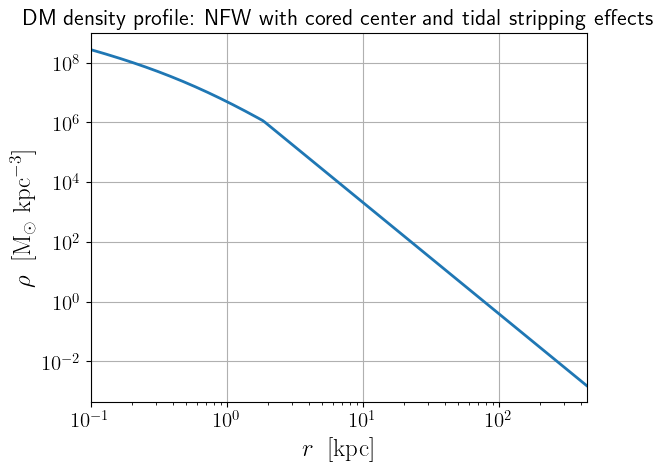

In [57]:
fig, ax = plt.subplots()
ax.xaxis.set_tick_params(labelsize=15)
ax.yaxis.set_tick_params(labelsize=15)
ax.set_xscale("log")
ax.set_yscale("log")
r = jnp.logspace(jnp.log10(100 * u.from_pc), jnp.log10(r99), 200)
ax.plot(r * u.to_Kpc, rho(r, density_params) * u.to_Msun/u.to_Kpc**3)
ax.set_ylabel(r"$\rho \;\;\mathrm{[M_\odot\;kpc^{-3}]}$", fontsize = 18)
ax.set_xlabel(r"$r \;\;\mathrm{[kpc]}$", fontsize = 18)
ax.set_title('DM density profile: NFW with cored center and tidal stripping effects', fontsize = 16)
plt.show()


In [58]:
potential = jax.vmap(jsp.potential, in_axes=(0,None))

In [59]:
rmin = .1 * u.from_pc
rmax = jsp.enclosing_radius(0.999, density_params)
N = 512
potential_params = jsp.init_potential_params(density_params, rmin, rmax, N) 
potential_params

potential_params:
	name=354410778964585829,
	density_params=236146193804778771,
	N=512,
	rmin=4.704688854379371e-06,
	rmax=488.5326223948342,

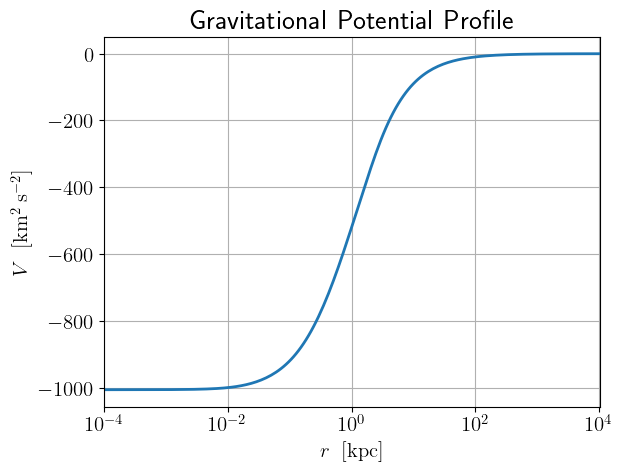

In [60]:
fig, ax = plt.subplots()
ax.set_xscale("log")
ax.xaxis.set_tick_params(labelsize=15)
ax.yaxis.set_tick_params(labelsize=15)
r = jnp.logspace(jnp.log10(rmin), jnp.log10(rmax), 200)
ax.plot(r * u.to_Kpc, potential(r, potential_params) * u.to_kms**2)
ax.set_ylabel(r"$V \;\;\mathrm{[km^2 \;s^{-2}]}$", fontsize = 15)
ax.set_xlabel(r"$r \;\;\mathrm{[kpc]}$", fontsize = 15)

ax.set_title('Gravitational Potential Profile', fontsize = 20)
plt.show()

In [61]:
eval_library = jax.vmap(jax.vmap(jsp.eval_radial_eigenmode, in_axes=(None, 0)), in_axes=(0,None))

In [62]:
rmin = .1 * u.from_pc
rmax = jsp.enclosing_radius(0.99, density_params)
N = 1024
a = 1
b = 10
eigenstate_lib = jsp.init_eigenstate_library(potential_params, rmin, rmax, a, b, N)
eigenstate_lib

eigenstate_library:
	name=720428951175803208,
	potential_params=354410778964585829,
	total number of modes=290,
	lmax=23,
	nmax=22,
	Emin=-366.4324756825,
	Emax=-2.7326364531013496

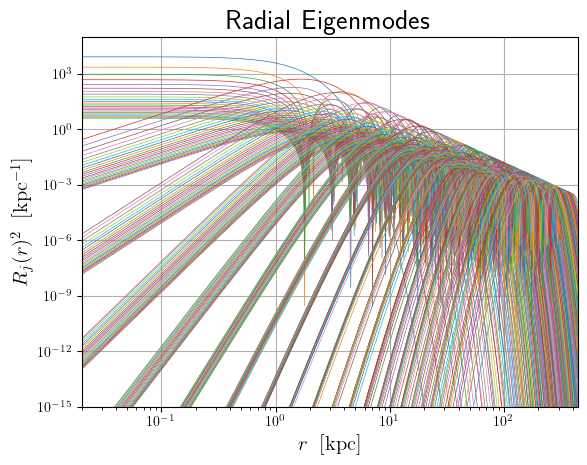

In [63]:
fig, ax = plt.subplots()
ax.set_xscale("log")
ax.set_yscale("log")
r = jnp.logspace(jnp.log10(20 * u.from_pc), jnp.log10(rmax), 1000)
R_j_r = eval_library(r, eigenstate_lib.radial_eigenmode_params)
ax.set_title('Radial Eigenmodes', fontsize = 20)
ax.set_xlabel(r"$r \;\;\mathrm{[kpc]}$", fontsize = 15)
ax.set_ylabel(r"$R_{j}(r)^2 \;\;\mathrm{[kpc^{-1}]}$", fontsize = 15)
ax.plot(r * u.to_Kpc, R_j_r**2, lw=0.5)
ax.set_ylim([1e-15, 1e5])
plt.show()

In [64]:
rho_psi = jax.vmap(jsp.rho_psi, in_axes=(0,None,None))

In [65]:
tol = 1e-7
rmin = 20 * u.from_pc
rmax = jsp.enclosing_radius(0.99, density_params)
wavefunction_params = jsp.init_wavefunction_params(eigenstate_lib, density_params, rmin, rmax, tol)
wavefunction_params

wavefunction_params:
	name=321443324063497960,
	eigenstate_library=720428951175803208,
	density_params=236146193804778771,
	aj_2=[4.006504847517604e-17, 0.6378985108831035],
	total_mass=716.415885628137,
	r_min=0.000940937770875874,
	r_max=20.743367613524313,
	distance=0.030344084526876418,

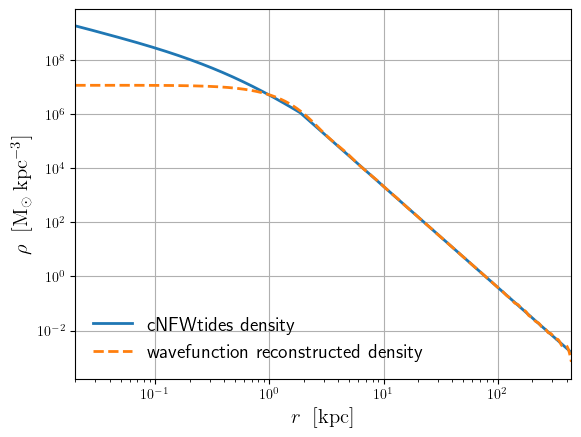

In [66]:
fig, ax = plt.subplots()
ax.set_xscale("log")
ax.set_yscale("log")

r = jnp.logspace(jnp.log10(rmin), jnp.log10(rmax), 1000)
ax.plot(r * u.to_Kpc, rho(r, density_params) * u.to_Msun / u.to_Kpc**3, label='cNFWtides density')
ax.plot(r * u.to_Kpc, rho_psi(r, wavefunction_params, eigenstate_lib) * u.to_Msun / u.to_Kpc**3, label='wavefunction reconstructed density', ls='--')
ax.set_ylabel(r"$\rho \;\;\mathrm{[M_\odot\;kpc^{-3}]}$", fontsize = 15)
ax.set_xlabel(r"$r \;\;\mathrm{[kpc]}$", fontsize = 15)
plt.legend(fontsize = 14)
plt.show()

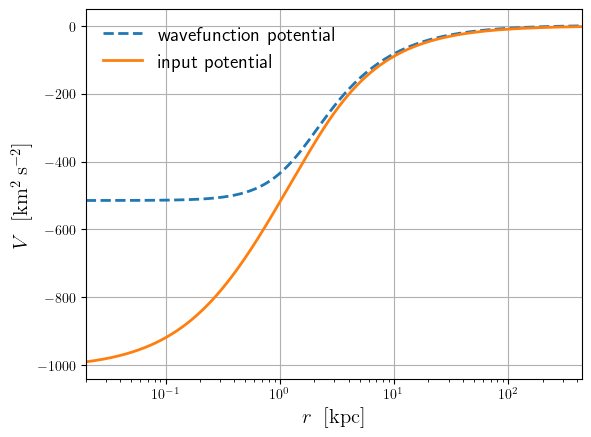

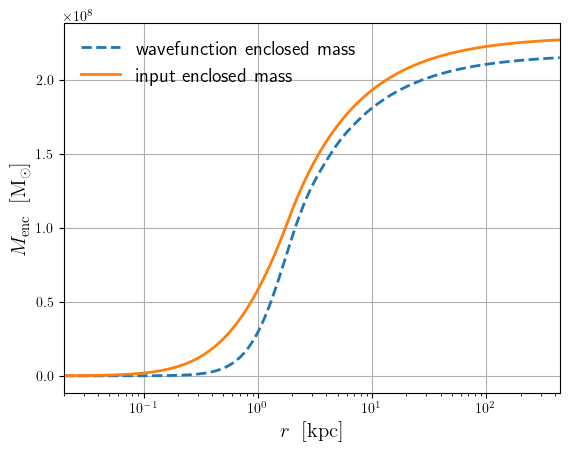

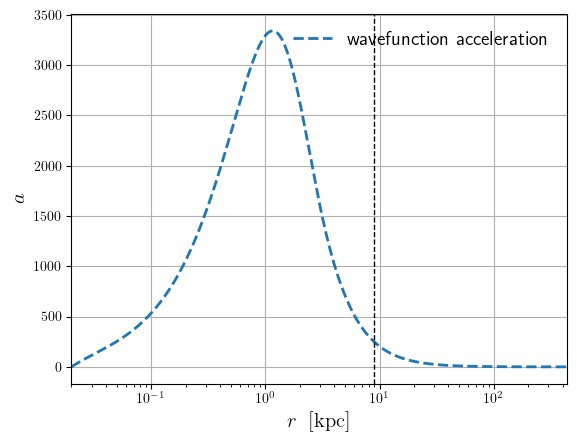

In [67]:

r_lin = np.linspace(rmin, rmax, 1000)

rho_psi_vals = rho_psi(r, wavefunction_params, eigenstate_lib)

Phi_psi = SSF.Obtain_pot(rmin, rmax, rho_psi_vals, r)

M_enc = SSF.Enclosed_mass(r, rho_psi_vals)

fig, ax = plt.subplots()
ax.set_xscale("log")
ax.plot(r * u.to_Kpc, Phi_psi * u.to_kms**2, label='wavefunction potential', lw=2, ls='--')
ax.plot(r * u.to_Kpc, potential(r, potential_params) * u.to_kms**2, label='input potential', lw=2)
ax.set_ylabel(r"$V \;\;\mathrm{[km^2 \;s^{-2}]}$", fontsize = 15)
ax.set_xlabel(r"$r \;\;\mathrm{[kpc]}$", fontsize = 15)
plt.legend(fontsize = 14)
plt.show()

fig, ax = plt.subplots()
ax.set_xscale("log")
ax.plot(r * u.to_Kpc, M_enc * u.to_Msun, label='wavefunction enclosed mass', lw=2, ls='--')
ax.plot(r * u.to_Kpc, jsp.enclosed_mass(r, density_params) * u.to_Msun, label='input enclosed mass', lw=2)
ax.set_ylabel(r"$M_{\mathrm{enc}} \;\;\mathrm{[M_\odot]}$", fontsize = 15)
ax.set_xlabel(r"$r \;\;\mathrm{[kpc]}$", fontsize = 15)
plt.legend(fontsize = 14)
plt.show()

G = GN.value * (u.from_cm**3) / (u.from_g * u.from_s**2)

acc = M_enc * G / r**2


fig, ax = plt.subplots()
ax.set_xscale("log")
ax.plot(r * u.to_Kpc, acc, label='wavefunction acceleration', lw=2, ls='--')
ax.set_ylabel(r"$a$", fontsize = 15)
ax.set_xlabel(r"$r \;\;\mathrm{[kpc]}$", fontsize = 15)
plt.legend(fontsize = 14)
plt.axvline(x = 9, color='k', ls='--', lw=1)
plt.show()



246.87545754656992


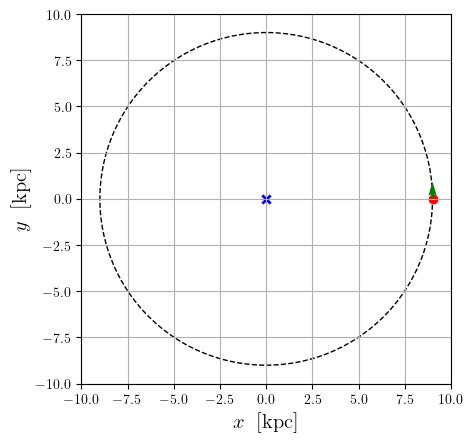

In [68]:

r_orbit = 9 * u.from_Kpc

init_pos = np.array([r_orbit, 0, 0]) #Starting as position (r_vir, 0, 0) = (x, y, z)

#at r_orbit, need to find value of the force from the wavefunction potential

acc_mag = SSF.Find_acc_mag_from_Phi(r, Phi_psi, r_orbit)

print(acc_mag)

init_vel = np.sqrt(acc_mag * r_orbit) * np.array([0, 1, 0]) #Circular orbit velocity (vx, vy, vx)

init_pos_sph = SSF.Cartesian_to_sph(init_pos[0], init_pos[1], init_pos[2])

init_vel_sph = SSF.Cartesian_to_sph_vel(init_pos[0], init_pos[1], init_pos[2], init_vel[0], init_vel[1], init_vel[2])

orbit = plt.Circle((0, 0), r_orbit * u.to_Kpc, color='black', fill=False, linestyle='--', label='Star Orbit')
fig, ax = plt.subplots() 

ax.add_patch(orbit)
ax.set_xlim(-10 , 10)
ax.set_ylim(-10 , 10)

ax.set_aspect('equal', adjustable='box')

plt.scatter(r_orbit * u.to_Kpc, 0, color='red', label='Star Initial Position')
plt.scatter(0, 0, color='blue', label='Halo Center', marker='x')
plt.quiver(r_orbit * u.to_Kpc, 0, 0, init_vel[1] * u.to_kms, label='Star Initial Velocity', angles='xy', scale_units='xy', scale=10, color='green')

ax.set_xlabel(r"$x \;\;\mathrm{[kpc]}$", fontsize = 15)
ax.set_ylabel(r"$y \;\;\mathrm{[kpc]}$", fontsize = 15)
plt.show()


In [69]:

total_evolve_time = 10 * u.from_Gyr
num_steps = 10000
dt = total_evolve_time / num_steps


r_pos = init_pos
v = init_vel

velocities = [init_vel_sph]

stellar_vel_disp_no_t = [0]

avg_r = init_pos_sph[0]

total_mag_r_no_t = [avg_r]
total_avg_r_no_t = [avg_r]


for i in range(num_steps-1):
    r_pos_dt, v_dt, vel_disp, avg_r, r_mag, velocities = SSF.Time_step_t_indep(r_pos, v, dt, acc_mag, velocities, avg_r, i)
    r_pos = r_pos_dt
    v = v_dt
    stellar_vel_disp_no_t.append(vel_disp)
    total_mag_r_no_t.append(r_mag)
    total_avg_r_no_t.append(avg_r)

final_r = r_pos

print(final_r* u.to_Kpc)

velocities = np.array(velocities)


[-4.45119868 -7.824221    0.        ]


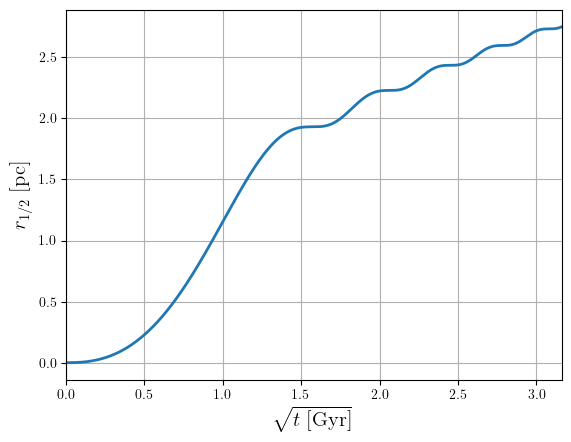

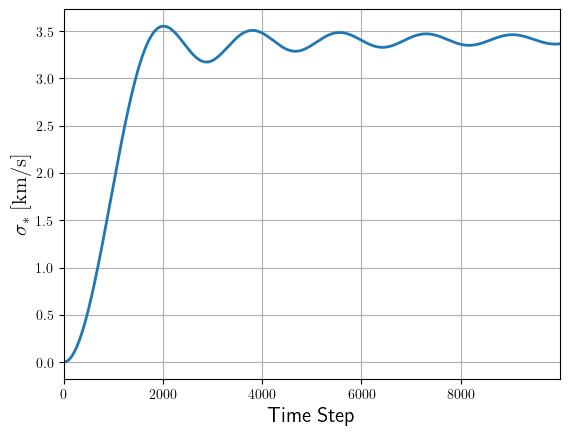

In [70]:

m_dm = 1 * 10**(-22) * 1.6 * 10**(-19) / (3 * 10**(8))**2  # mass of dark matter particle in units of 10^-22 eV

h_bar = hbar.value * 1e-7

t = [i * dt for i in range(num_steps)] # time

t = np.array(t) * u.to_s

dm_v_disp = 6000 # m/s from paper

stellar_v_disp_plot_no_t = np.array(stellar_vel_disp_no_t) * u.to_cm / (u.to_s * 100)

r_half_no_t = (9 * (h_bar / m_dm)**3 * t * (stellar_v_disp_plot_no_t**2)/(dm_v_disp**4))**(1/4)


m_to_pc = 3.24078 * 10**(-19)
s_to_Gyr = 3.16888 * 10**(-17)

fig, ax = plt.subplots()

plt.plot(np.sqrt(t * s_to_Gyr), r_half_no_t * m_to_pc, label='Predicted Half-Light Radius without time dependence', lw=2)
plt.xlabel(r'$\sqrt{t\;\mathrm{[Gyr]}}$', fontsize=15)
plt.ylabel(r'$r_{1/2}\;\mathrm{[pc]}$', fontsize=15)
plt.show()

plt.plot(np.arange(num_steps), stellar_v_disp_plot_no_t, label='Stellar Velocity Dispersion without time dependence', lw=2)
plt.xlabel(r'Time Step', fontsize=15)
plt.ylabel(r'$\sigma_*\;\mathrm{[km/s]}$', fontsize=15)
plt.show()





### Convergence Plot

[    10     20     30 ...  99980  99990 100000]


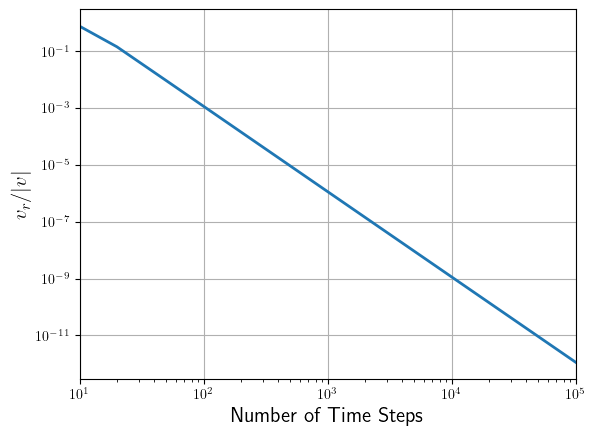

Slope: [-2.99964344]
Intercept: [3.05935032]
Coefficient: [1146.43732128]


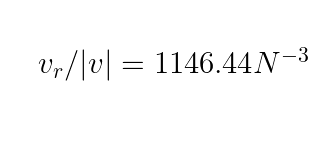

In [71]:

total_evolve_time = 10 * u.from_Gyr
num_steps = np.linspace(10, 100000, dtype=int, num = 10000)
dt = total_evolve_time / num_steps

print(num_steps)

vr_perc_at_dt= defaultdict(list)


for j in range(len(num_steps)):

    r_pos = init_pos
    v = init_vel
    velocities = [init_vel_sph]
    avg_r = init_pos_sph[0]

    r_pos_dt, v_dt, vel_disp, avg_r, r_mag, velocities = SSF.Time_step_t_indep(r_pos, v, dt[j], acc_mag, velocities, avg_r, i = 1)
    r_pos = r_pos_dt
    v = v_dt

    v_r_perc = velocities[-1][0] / np.linalg.norm(velocities[-1])

    vr_perc_at_dt[num_steps[j]].append(v_r_perc)

plt.plot(list(vr_perc_at_dt.keys()), list(vr_perc_at_dt.values()), lw=2)
plt.xlabel(r'Number of Time Steps', fontsize=15)
plt.ylabel(r'$v_{r} / |v|$', fontsize=15)
plt.yscale('log')
plt.xscale('log')
plt.legend()
plt.show()

log_num_steps = np.log10(list(vr_perc_at_dt.keys()))
log_vr_perc = np.log10(list(vr_perc_at_dt.values()))


slope, intercept = np.polyfit(log_num_steps, log_vr_perc, 1)

print("Slope:", slope)
print("Intercept:", intercept)

coefficient = 10**intercept

print("Coefficient:", coefficient)

plt.figure(figsize=(2, 1), dpi=150)
plt.text(0.1, 0.5, r'$v_r / |v| = %.2f N^{%.0f}$' % (coefficient, slope), fontsize=15)
plt.axis('off')
plt.show()



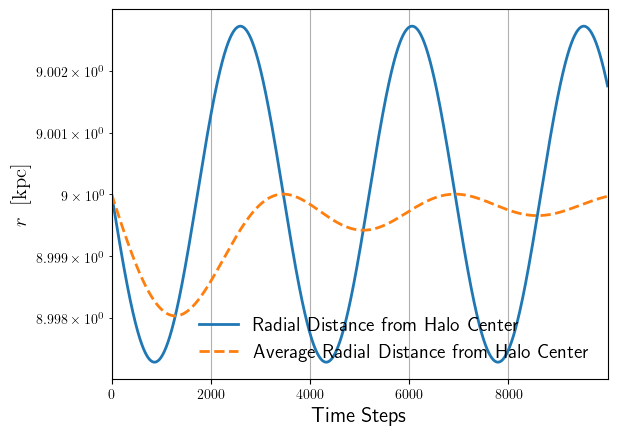

In [72]:
fig, ax = plt.subplots()

total_mag_r_no_t = jnp.array(total_mag_r_no_t)
total_avg_r_no_t = jnp.array(total_avg_r_no_t)

num_steps = 10000


ax.plot(np.arange(num_steps), jnp.array(total_mag_r_no_t) * u.to_Kpc, label='Radial Distance from Halo Center')
ax.plot(np.arange(num_steps), jnp.array(total_avg_r_no_t) * u.to_Kpc, label='Average Radial Distance from Halo Center', ls='--')
ax.set_ylabel(r"$r \;\;\mathrm{[kpc]}$", fontsize = 15)
ax.set_xlabel(r"Time Steps", fontsize = 15)
ax.set_yscale('log')
plt.legend(fontsize = 14)
plt.show()

KeyboardInterrupt: 

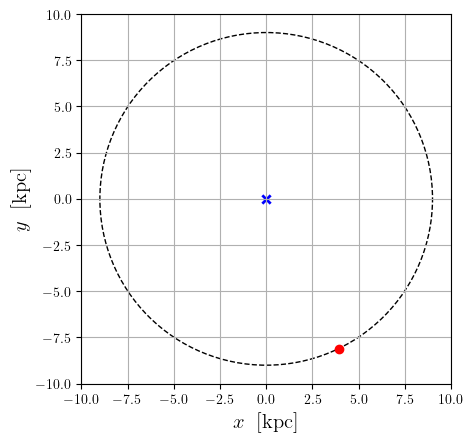

In [73]:
total_evolve_time = 10 * u.from_Gyr
num_steps = 10000
dt = total_evolve_time / num_steps

ani = SSF.Make_animation_t_indep(r_orbit, init_pos, init_vel, dt, num_steps, acc_mag)

HTML(ani.to_jshtml())

### Leap-frog Integrator Convergence plot

[    10     20     30 ...  99980  99990 100000]


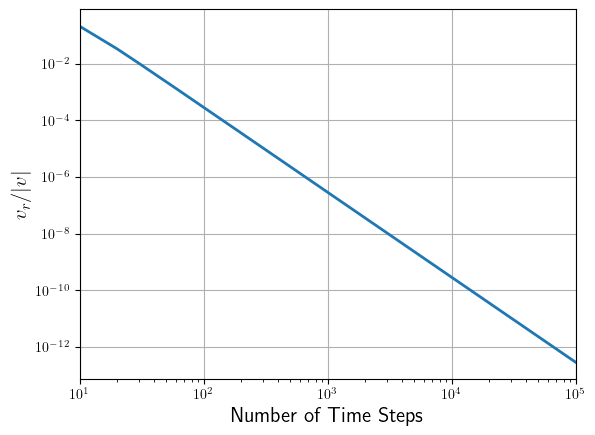

Slope: [-2.99961413]
Intercept: [2.45715363]
Coefficient: [286.51913082]


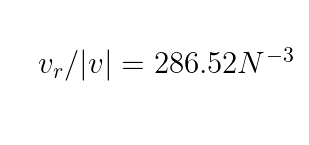

In [74]:

total_evolve_time = 10 * u.from_Gyr
num_steps = np.linspace(10, 100000, dtype=int, num = 10000)
dt = total_evolve_time / num_steps

print(num_steps)

vr_perc_at_dt= defaultdict(list)


for j in range(len(num_steps)):

    r_pos = init_pos
    v = init_vel
    velocities = [init_vel_sph]
    avg_r = init_pos_sph[0]

    r_pos_dt, v_dt, vel_disp, avg_r, r_mag, velocities = SSF.Time_step_t_indep_leapfrog(r_pos, v, dt[j], acc_mag, velocities, avg_r, i = 1)
    r_pos = r_pos_dt
    v = v_dt

    v_r_perc = velocities[-1][0] / np.linalg.norm(velocities[-1])

    vr_perc_at_dt[num_steps[j]].append(v_r_perc)

plt.plot(list(vr_perc_at_dt.keys()), list(vr_perc_at_dt.values()), lw=2)
plt.xlabel(r'Number of Time Steps', fontsize=15)
plt.ylabel(r'$v_{r} / |v|$', fontsize=15)
plt.yscale('log')
plt.xscale('log')
plt.legend()
plt.show()

log_num_steps = np.log10(list(vr_perc_at_dt.keys()))
log_vr_perc = np.log10(list(vr_perc_at_dt.values()))


slope, intercept = np.polyfit(log_num_steps, log_vr_perc, 1)

print("Slope:", slope)
print("Intercept:", intercept)

coefficient = 10**intercept

print("Coefficient:", coefficient)

plt.figure(figsize=(2, 1), dpi=150)
plt.text(0.1, 0.5, r'$v_r / |v| = %.2f N^{%.0f}$' % (coefficient, slope), fontsize=15)
plt.axis('off')
plt.show()



### Hanno Reins Integrator Convergence plot

[    10     20     30 ...  99980  99990 100000]


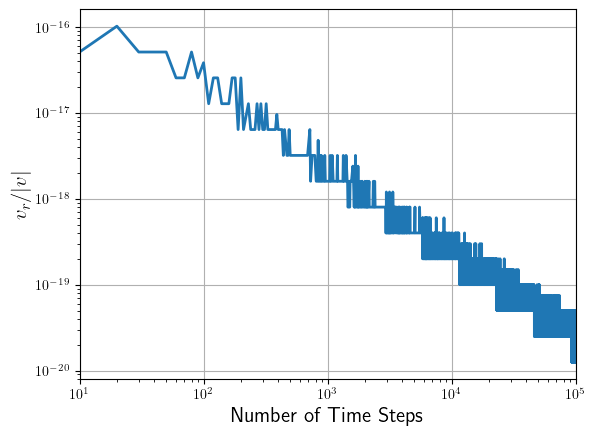

In [75]:
import Stellar_sim_funcs as SSF
import importlib
importlib.reload(SSF)


total_evolve_time = 10 * u.from_Gyr
num_steps = np.linspace(10, 100000, dtype=int, num = 10000)
dt = total_evolve_time / num_steps

print(num_steps)

vr_perc_at_dt= defaultdict(list)


for j in range(len(num_steps)):

    r_pos = init_pos
    v = init_vel
    velocities = [init_vel_sph]
    avg_r = init_pos_sph[0]

    r_pos_dt, v_dt, vel_disp, avg_r, r_mag, velocities = SSF.Time_step_t_indep_Hanno_reins(r_pos, v, dt[j], acc_mag, velocities, avg_r, i = 1)
    r_pos = r_pos_dt
    v = v_dt

    v_r_perc = velocities[-1][0] / np.linalg.norm(velocities[-1])

    vr_perc_at_dt[num_steps[j]].append(v_r_perc)


mask = np.array(list(vr_perc_at_dt.values())).flatten() > 0

vr_perc_at_dt_values = np.array(list(vr_perc_at_dt.values()))[mask]
vr_perc_at_dt_keys = np.array(list(vr_perc_at_dt.keys()))[mask]

plt.plot(list(vr_perc_at_dt_keys), list(vr_perc_at_dt_values), lw=2)
plt.xlabel(r'Number of Time Steps', fontsize=15)
plt.ylabel(r'$v_{r} / |v|$', fontsize=15)
plt.yscale('log')
plt.xscale('log')
plt.legend()
plt.show()


Ignoring fixed y limits to fulfill fixed data aspect with adjustable data limits.
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


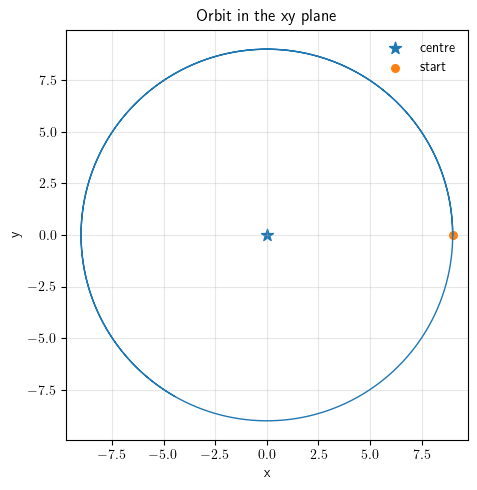

In [76]:
import numpy as np
import matplotlib.pyplot as plt

# if you already have spherical versions, use those instead:
init_pos_sph = SSF.Cartesian_to_sph(*init_pos)
init_vel_sph = SSF.Cartesian_to_sph_vel(*init_pos, *init_vel)

# --- integration parameters ---
total_evolve_time = 10 * u.from_Gyr
num_steps = 10000
dt = total_evolve_time / num_steps

r_pos   = init_pos.copy()
v       = init_vel.copy()
avg_r   = init_pos_sph[0]
velocities = [init_vel_sph]

xs, ys = [], []   # store orbit in the orbital plane

for i in range(num_steps):
    xs.append(r_pos[0])
    ys.append(r_pos[1])

    r_pos, v, vel_disp, avg_r, r_mag, velocities = SSF.Time_step_t_indep_Hanno_reins(
        r_pos, v, dt, acc_mag, velocities, avg_r, i
    )

xs = np.array(xs)
ys = np.array(ys)

# --- plot the orbit ---
plt.figure(figsize=(5, 5))
plt.plot(xs * u.to_Kpc, ys * u.to_Kpc, lw=1)

# mark origin and starting point
plt.scatter(0.0, 0.0, marker='*', s=80, label='centre')
plt.scatter(xs[0] * u.to_Kpc, ys[0] * u.to_Kpc, marker='o', s=30, label='start')

plt.xlabel('x')
plt.ylabel('y')
plt.title('Orbit in the xy plane')
plt.axis('equal')        # so orbit isn’t squashed
plt.grid(True, alpha=0.3)
plt.xlim(-10, 10)
plt.ylim(-10, 10)
plt.legend()
plt.tight_layout()
plt.show()


# With Time Evolution

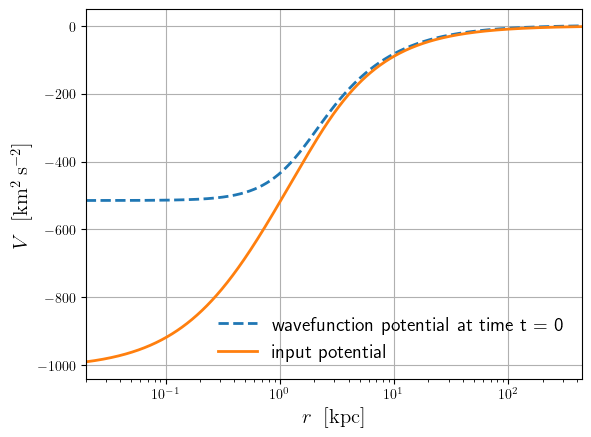

3132.937568921591


In [77]:
r = np.logspace(np.log10(rmin), np.log10(rmax), 1000)

Phi_psi = SSF.Obtain_pot(rmin, rmax, rho_psi_vals, r)

fig, ax = plt.subplots()
ax.set_xscale("log")
ax.plot(r * u.to_Kpc, Phi_psi * u.to_kms**2, label='wavefunction potential at time t = 0', lw=2, ls='--')
ax.plot(r * u.to_Kpc, potential(r, potential_params) * u.to_kms**2, label='input potential', lw=2)
ax.set_ylabel(r"$V \;\;\mathrm{[km^2 \;s^{-2}]}$", fontsize = 15)
ax.set_xlabel(r"$r \;\;\mathrm{[kpc]}$", fontsize = 15)
plt.legend(fontsize = 14)
plt.show()

m_dm = 1 * 10**(-22) * 1.6 * 10**(-19) / (3 * 10**(8))**2  # mass of dark matter particle in units of 10^-22 eV

h_bar = hbar.value * 1e-7

dt_De_B = h_bar / (m_dm * 6000) * u.from_s # in seconds

print(dt_De_B * u.to_Gyr)

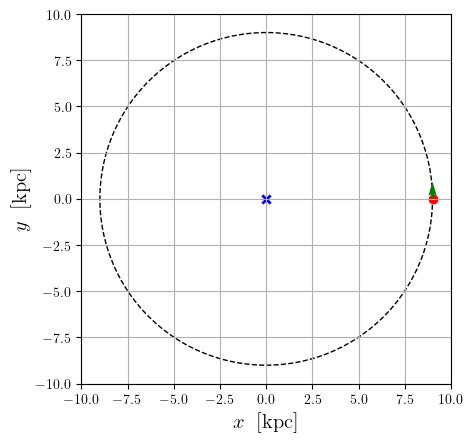

In [100]:
r_orbit = 9 * u.from_Kpc

init_pos = np.array([r_orbit, 0, 0]) #Starting as position (r_vir, 0, 0) = (x, y, z)

#at r_orbit, need to find value of the force from the wavefunction potential

acc_mag = SSF.Find_acc_mag_from_Phi(r, Phi_psi, r_orbit)

init_vel = np.sqrt(acc_mag * r_orbit) * np.array([0, 1, 0]) #Circular orbit velocity (vx, vy, vz)

init_pos_sph = SSF.Cartesian_to_sph(init_pos[0], init_pos[1], init_pos[2])
init_vel_sph = SSF.Cartesian_to_sph_vel(init_pos[0], init_pos[1], init_pos[2], init_vel[0], init_vel[1], init_vel[2])

orbit = plt.Circle((0, 0), r_orbit * u.to_Kpc, color='black', fill=False, linestyle='--', label='Star Orbit')
fig, ax = plt.subplots() 

ax.add_patch(orbit)
ax.set_xlim(-10 , 10)
ax.set_ylim(-10 , 10)

ax.set_aspect('equal', adjustable='box')

plt.scatter(r_orbit * u.to_Kpc, 0, color='red', label='Star Initial Position')
plt.scatter(0, 0, color='blue', label='Halo Center', marker='x')
plt.quiver(r_orbit * u.to_Kpc, 0, 0, init_vel[1] * u.to_kms, label='Star Initial Velocity', angles='xy', scale_units='xy', scale=10, color='green')

ax.set_xlabel(r"$x \;\;\mathrm{[kpc]}$", fontsize = 15)
ax.set_ylabel(r"$y \;\;\mathrm{[kpc]}$", fontsize = 15)
plt.show()


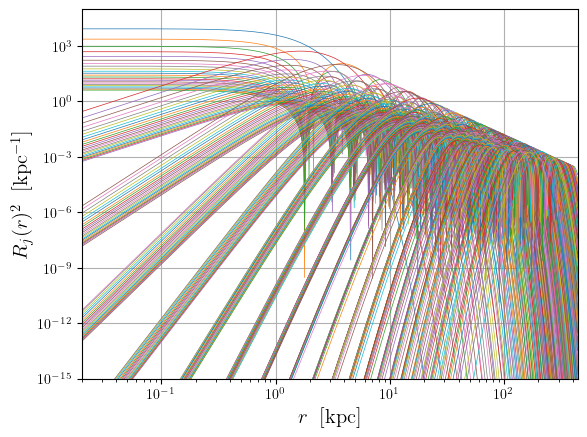

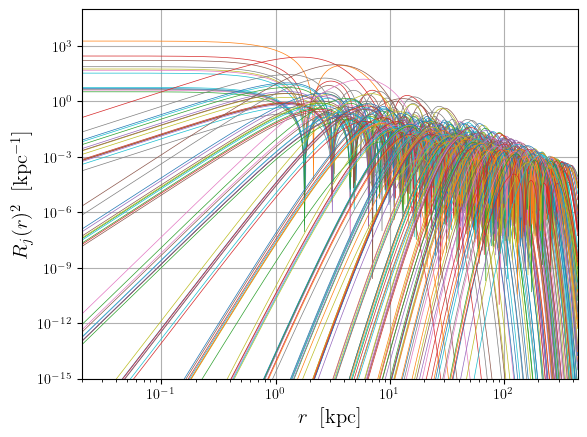

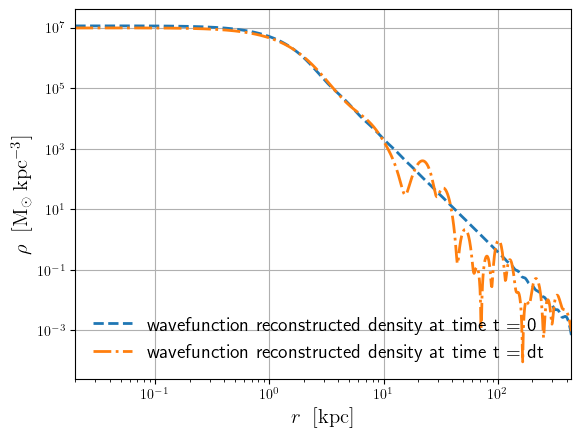

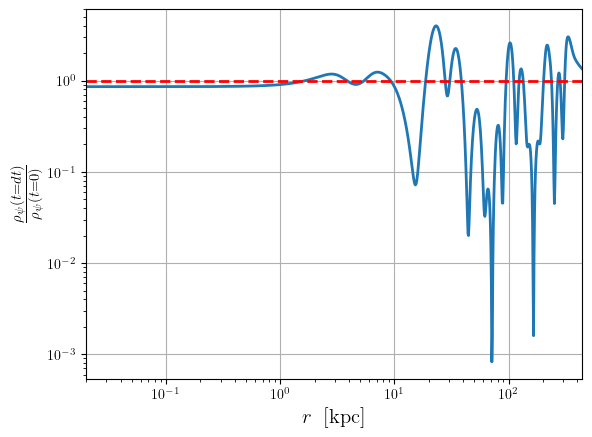

In [82]:
r = jnp.logspace(jnp.log10(rmin), jnp.log10(rmax), 1000)


eigen_energies = eigenstate_lib.radial_eigenmode_params.E

l = eigenstate_lib.radial_eigenmode_params.l

aj_2 = wavefunction_params.aj_2

theta = jax.random.uniform(jax.random.PRNGKey(0), shape=aj_2.shape, minval=0.0, maxval=2*jnp.pi)

aj = jnp.sqrt(aj_2) * jnp.exp(1j * theta)

total_mass = wavefunction_params.total_mass

R_j_r = eval_library(r, eigenstate_lib.radial_eigenmode_params)

radial_eigen_functions = R_j_r

plt.plot(r * u.to_Kpc, radial_eigen_functions**2, lw=0.5)
plt.xlabel(r"$r \;\;\mathrm{[kpc]}$", fontsize=15)
plt.ylabel(r"$R_{j}(r)^2 \;\;\mathrm{[kpc^{-1}]}$", fontsize=15)
plt.xscale("log")
plt.yscale("log")
plt.ylim([1e-15, 1e5])
plt.xlim([rmin * u.to_Kpc, rmax * u.to_Kpc])
plt.show()


radial_eigen_function_time_stepped = radial_eigen_functions * jnp.exp(-1j * dt * eigen_energies  / hbar.value)

Y_l0 = jnp.sqrt((2*l.squeeze()+1)/(4*jnp.pi))

full_psi = jnp.sum(aj * Y_l0 * radial_eigen_function_time_stepped, axis=1)

total_psi_2 = (total_mass) * jnp.abs(full_psi)**2

rho_psi_time_stepped = total_psi_2

plt.plot(r * u.to_Kpc, radial_eigen_function_time_stepped**2, lw=0.5)
plt.xlabel(r"$r \;\;\mathrm{[kpc]}$", fontsize=15)
plt.ylabel(r"$R_{j}(r)^2 \;\;\mathrm{[kpc^{-1}]}$", fontsize=15)
plt.xscale("log")
plt.yscale("log")
plt.ylim([1e-15, 1e5])
plt.show()


fig, ax = plt.subplots()
ax.set_xscale("log")
ax.set_yscale("log")
ax.plot(r * u.to_Kpc, rho_psi(r, wavefunction_params, eigenstate_lib) * u.to_Msun / u.to_Kpc**3, label='wavefunction reconstructed density at time t = 0', ls='--')
ax.plot(r * u.to_Kpc, rho_psi_time_stepped * u.to_Msun / u.to_Kpc**3, label='wavefunction reconstructed density at time t = dt', ls='-.')
ax.set_ylabel(r"$\rho \;\;\mathrm{[M_\odot\;kpc^{-3}]}$", fontsize = 15)
ax.set_xlabel(r"$r \;\;\mathrm{[kpc]}$", fontsize = 15)
plt.legend(fontsize = 14)
plt.show()

fraction = rho_psi_time_stepped / rho_psi(r, wavefunction_params, eigenstate_lib)
plt.plot(r * u.to_Kpc, fraction)
plt.xlabel(r"$r \;\;\mathrm{[kpc]}$", fontsize=15)
plt.ylabel(r"$\frac{\rho_{\psi}(t=dt)}{\rho_{\psi}(t=0)}$", fontsize=15)
plt.axhline(1, color='red', ls='--')
plt.xscale("log")
plt.yscale("log")
plt.show()


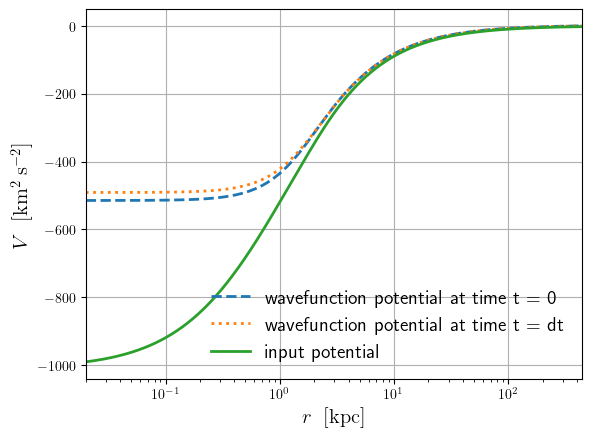

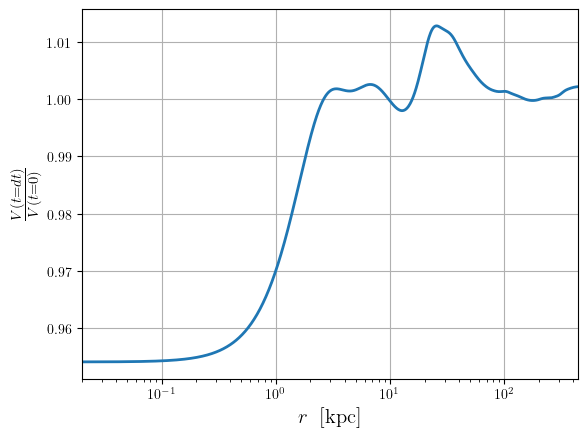

In [83]:

Phi_psi_dt = SSF.Obtain_pot(rmin, rmax, rho_psi_time_stepped, r)

fig, ax = plt.subplots()
ax.set_xscale("log")


ax.plot(r * u.to_Kpc,  Phi_psi * u.to_kms**2, label='wavefunction potential at time t = 0', lw=2, ls='--')
ax.plot(r * u.to_Kpc, Phi_psi_dt * u.to_kms**2, label='wavefunction potential at time t = dt', lw=2, ls=':')
ax.plot(r * u.to_Kpc, potential(r, potential_params) * u.to_kms**2, label='input potential', lw=2)
ax.set_ylabel(r"$V \;\;\mathrm{[km^2 \;s^{-2}]}$", fontsize = 15)
ax.set_xlabel(r"$r \;\;\mathrm{[kpc]}$", fontsize = 15)
plt.legend(fontsize = 14)
plt.show()


plt.plot(r * u.to_Kpc, Phi_psi_dt/Phi_psi)
plt.xscale('log')
plt.xlabel(r"$r \;\;\mathrm{[kpc]}$", fontsize=15)
plt.ylabel(r"$\frac{V(t=dt)}{V(t=0)}$", fontsize=15)
plt.show()

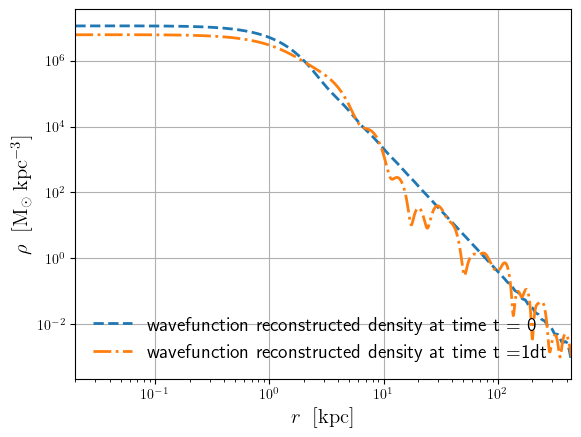

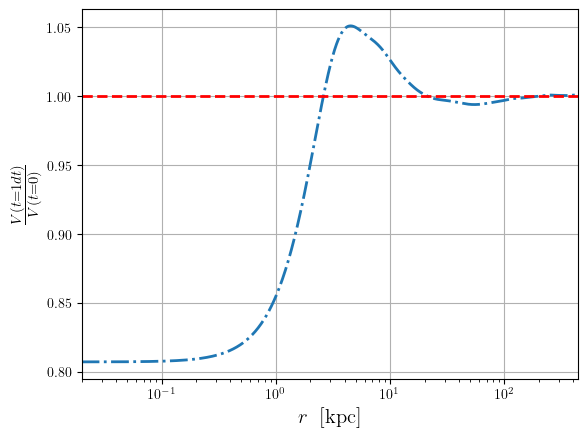

267.1831175091426


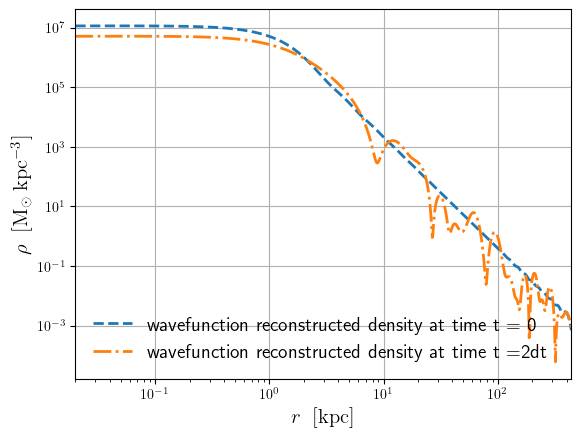

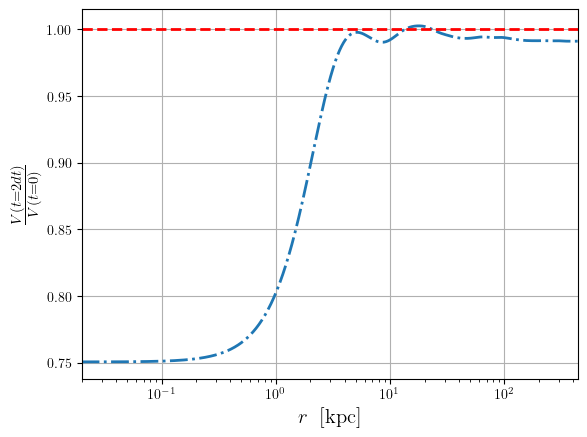

242.2767563190574


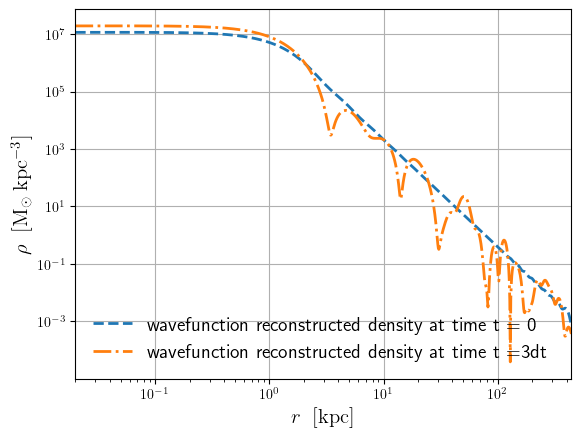

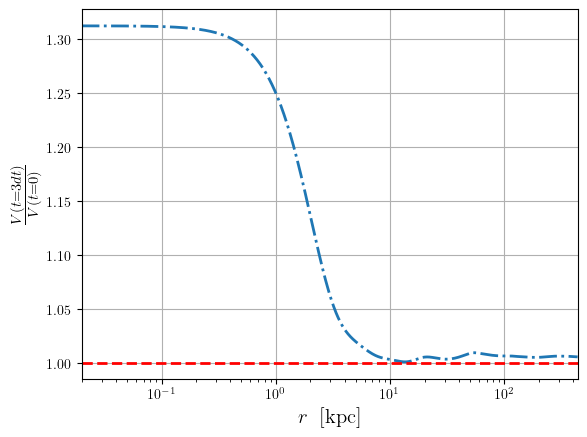

250.40989802508503


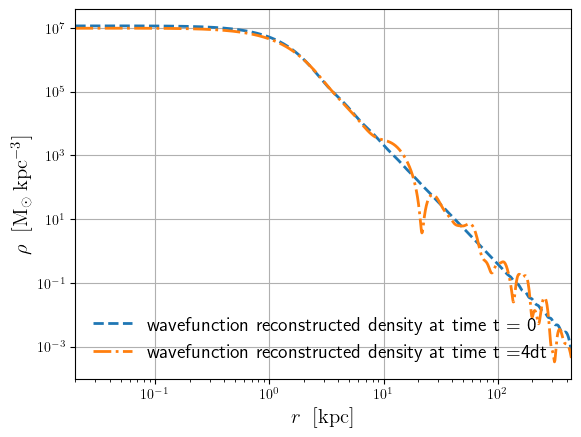

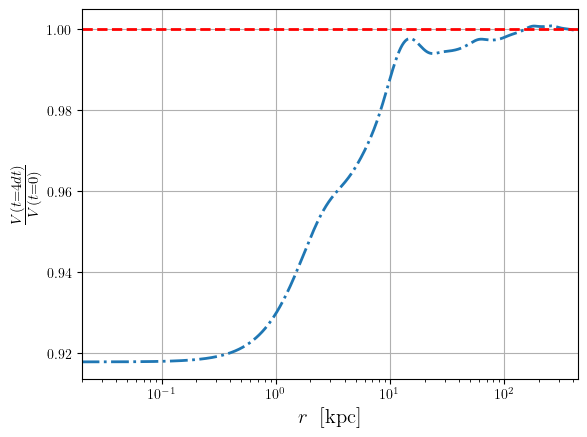

231.77429402710854


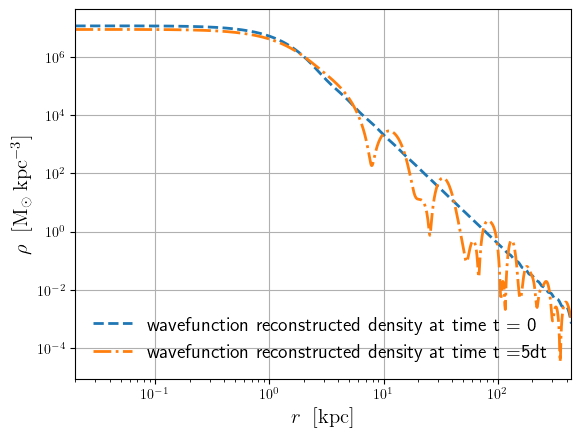

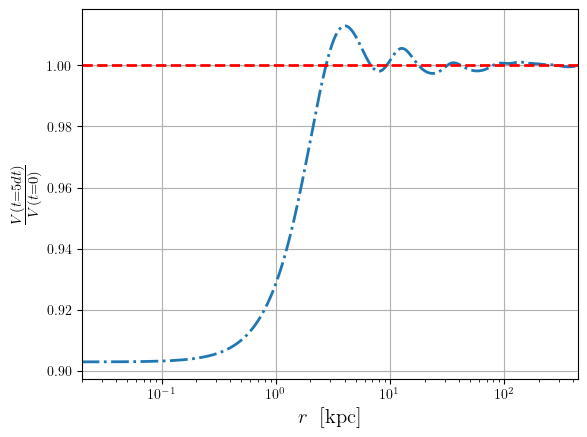

241.81625011478582
[8.46124344 2.78449219 0.        ]


In [84]:

dt = 60 * u.from_Myr
num_steps = 5

r_lin = np.linspace(rmin, rmax, 1000)
r_orbit = 9 * u.from_Kpc

acc_mag = SSF.Find_acc_mag_from_Phi(r, Phi_psi, r_orbit)

init_vel = np.sqrt(acc_mag * r_orbit) * np.array([0, 1, 0]) #Circular orbit velocity

eigen_energies = eigenstate_lib.radial_eigenmode_params.E
l = eigenstate_lib.radial_eigenmode_params.l

aj_2 = wavefunction_params.aj_2
theta = jax.random.uniform(jax.random.PRNGKey(0), shape=aj_2.shape, minval=0.0, maxval=2*jnp.pi)
aj = jnp.sqrt(aj_2)


total_mass = wavefunction_params.total_mass

R_j_r = eval_library(r, eigenstate_lib.radial_eigenmode_params)

radial_eigen_functions = R_j_r


r_pos = init_pos
v = init_vel


for i in range(num_steps):
    r_dt, v_dt, rho_psi_time_stepped = SSF.Time_step_t_dep(r_pos, v, dt, acc_mag, r, eigen_energies, l, radial_eigen_functions, aj, total_mass, k = i + 1)
    r_pos = r_dt
    v = v_dt
    
    fig, ax = plt.subplots()
    ax.set_xscale("log")
    ax.set_yscale("log")
    ax.plot(r * u.to_Kpc, rho_psi(r, wavefunction_params, eigenstate_lib) * u.to_Msun / u.to_Kpc**3, label='wavefunction reconstructed density at time t = 0', ls='--')
    ax.plot(r * u.to_Kpc, rho_psi_time_stepped * u.to_Msun / u.to_Kpc**3, label='wavefunction reconstructed density at time t =' + str(i+1) + 'dt', ls='-.')
    ax.set_ylabel(r"$\rho \;\;\mathrm{[M_\odot\;kpc^{-3}]}$", fontsize = 15)
    ax.set_xlabel(r"$r \;\;\mathrm{[kpc]}$", fontsize = 15)
    plt.legend(fontsize = 14)
    plt.show()

    Phi_psi_dt = SSF.Obtain_pot(rmin, rmax, rho_psi_time_stepped, r)

    fig, ax = plt.subplots()
    ax.set_xscale("log")
    ax.plot(r * u.to_Kpc,  Phi_psi_dt / Phi_psi, lw=2, ls='-.')
    ax.set_ylabel(r"$\frac{V(t="+ str(i+1) + "dt)}{V(t=0)}$", fontsize = 15)
    ax.set_xlabel(r"$r \;\;\mathrm{[kpc]}$", fontsize = 15)
    plt.legend(fontsize = 14)
    plt.axhline(1, color='red', ls='--')
    plt.show()

    acc_mag = SSF.Find_acc_mag_from_rho(r, rho_psi_time_stepped, r_orbit)

    print(acc_mag)


final_r = r_pos

print(final_r* u.to_Kpc)



246.87545754656625


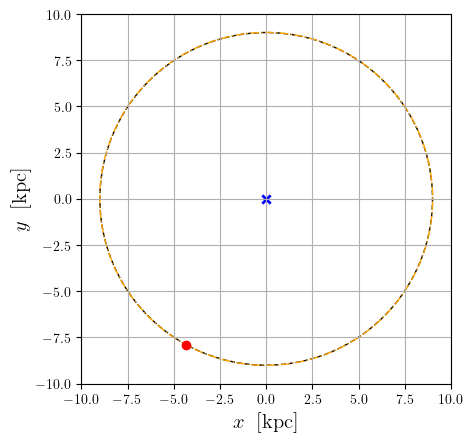

In [94]:

total_evolve_time = 10 * u.from_Gyr
num_steps = 1000
dt = total_evolve_time / num_steps

r = jnp.logspace(jnp.log10(rmin), jnp.log10(rmax), 1000)

r_orbit = 9 * u.from_Kpc
init_pos = np.array([r_orbit, 0, 0]) #Starting as position (r_vir, 0, 0) = (x, y, z)

acc_mag = SSF.Find_acc_mag_from_Phi(r, Phi_psi, r_orbit)

print(acc_mag)

init_vel = np.sqrt(acc_mag * r_orbit) * np.array([0, 1, 0]) #Circular orbit velocity

ani = SSF.Make_animation_t_dep(r_orbit, init_pos, init_vel, dt, num_steps, acc_mag, r, eigen_energies, l, radial_eigen_functions, aj, total_mass, rmin, rmax)

HTML(ani.to_jshtml())

In [95]:
total_evolve_time = 10 * u.from_Gyr
num_steps = 10000
dt = total_evolve_time / num_steps

r_orbit = 9 * u.from_Kpc
init_pos = np.array([r_orbit, 0, 0]) #Starting as position (r_vir, 0, 0) = (x, y, z)

total_mag_r, total_avg_r, stellar_v_disp = SSF.Simulate_time_dep(r_orbit, init_pos, dt, num_steps, r, eigen_energies, l, radial_eigen_functions, aj, total_mass, rmin, rmax, Phi_psi)



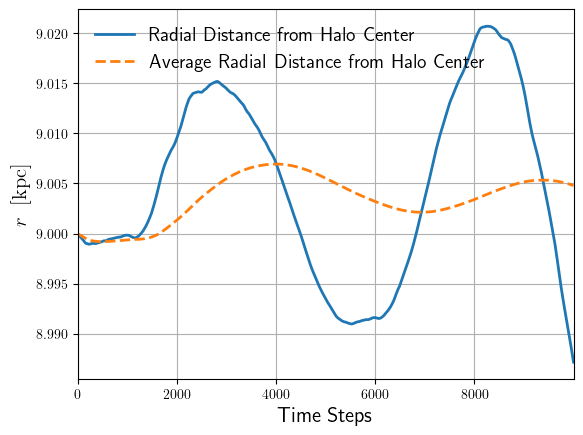

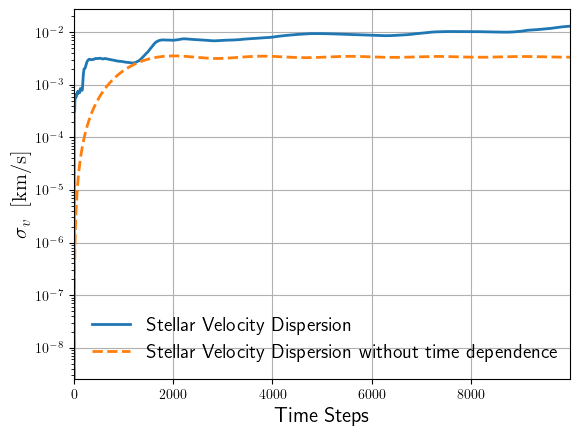

In [96]:
fig, ax = plt.subplots()

total_mag_r = jnp.array(total_mag_r)
total_avg_r = jnp.array(total_avg_r)


ax.plot(np.arange(num_steps), jnp.array(total_mag_r) * u.to_Kpc, label='Radial Distance from Halo Center')
ax.plot(np.arange(num_steps), jnp.array(total_avg_r) * u.to_Kpc, label='Average Radial Distance from Halo Center', ls='--')
ax.set_ylabel(r"$r \;\;\mathrm{[kpc]}$", fontsize = 15)
ax.set_xlabel(r"Time Steps", fontsize = 15)
plt.legend(fontsize = 14)
plt.show()

fig, ax = plt.subplots()

stellar_v_disp = jnp.array(stellar_v_disp)
stellar_vel_disp_no_t = jnp.array(stellar_vel_disp_no_t)

ax.plot(np.arange(num_steps), stellar_v_disp * u.to_kms, label='Stellar Velocity Dispersion')
ax.plot(np.arange(num_steps), stellar_vel_disp_no_t * u.to_kms, label='Stellar Velocity Dispersion without time dependence', ls='--')
plt.yscale('log')
ax.set_ylabel(r"$\sigma_v \;\;\mathrm{[km/s]}$", fontsize = 15)
ax.set_xlabel(r"Time Steps", fontsize = 15)
plt.legend(fontsize = 14)
plt.show()

In [97]:
m_dm = 1 * 10**(-22) * 1.6 * 10**(-19) / (3 * 10**(8))**2  # mass of dark matter particle in units of 10^-22 eV

h_bar = hbar.value * 1e-7

t = [i * dt for i in range(num_steps)] # time

t = np.array(t) * u.to_s

dm_v_disp = 6000 # m/s from paper

stellar_v_disp_plot = np.array(stellar_v_disp) * u.to_cm / (u.to_s * 100)

r_half = (9 * (h_bar / m_dm)**3 * t * (stellar_v_disp_plot**2)/(dm_v_disp**4))**(1/4)

m_to_pc = 3.24078 * 10**(-19)
s_to_Gyr = 3.16888 * 10**(-17)

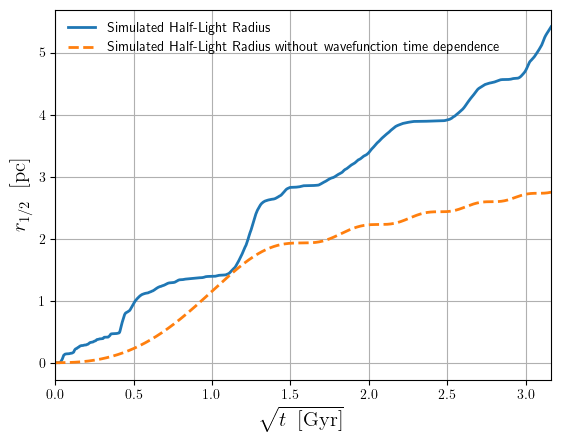

In [98]:

fig, ax = plt.subplots()

t_no_t = t


plt.plot(np.sqrt(t * s_to_Gyr) , r_half * m_to_pc, label='Simulated Half-Light Radius')
plt.plot(np.sqrt(t_no_t * s_to_Gyr), r_half_no_t * m_to_pc, label='Simulated Half-Light Radius without wavefunction time dependence', ls='--')

plt.xlabel(r"$\sqrt{t \;\;\mathrm{[Gyr]}}$", fontsize = 15)
plt.ylabel(r"$r_{1/2} \;\;\mathrm{[pc]}$", fontsize = 15)
plt.legend(fontsize = 10)

plt.show()

In [99]:
from scipy.interpolate import NearestNDInterpolator
import s2fft

In [ ]:
@jax.vmap
def rthetaphi_from(xyz):
    xy = xyz[0]**2 + xyz[1]**2
    r = jnp.sqrt(xy + xyz[2]**2)
    theta = jnp.arctan2(jnp.sqrt(xy), xyz[2]) 
    phi = jnp.arctan2(xyz[1], xyz[0])
    return jnp.array([r,theta,phi])

@jax.vmap
def xyz_from(rthetaphi):
    r, theta, phi = rthetaphi[0],rthetaphi[1],rthetaphi[2],
    x = r*jnp.cos(phi) * jnp.sin(theta)
    y = r*jnp.sin(phi) * jnp.sin(theta)
    z = r*jnp.cos(theta)
    return jnp.array([x,y,z])

def cartesian_product(*vecs):
    def cartesian_product(a, b):
        return jax.vmap(
            lambda a, b: jnp.c_[a * jnp.ones(b.shape[0]), b], in_axes=(0, None)
        )(a, b).reshape(-1, a.ndim + b.ndim)

    axb = cartesian_product(vecs[-2], vecs[-1])
    for vec in reversed(vecs[:-2]):
        axb = cartesian_product(vec, axb)
    return axb

: 

: 

In [ ]:
N = 256
R = 0.98 * wavefunction_params.r_fit
dx = 2*R/N
x = y = z = dx * jnp.arange(N) + dx / 2 - R


xyz = cartesian_product(x,y,z)
rthetaphi = rthetaphi_from(xyz)

: 

: 

In [ ]:
L = (eigenstate_lib.radial_eigenmode_params.l[-1]+1).item()

nside = L//2

r = jnp.linspace(wavefunction_params.r_min, R, 512)

theta = s2fft.sampling.s2_samples.thetas(L, sampling="healpix", nside=nside)
phi = [s2fft.sampling.s2_samples.phis_ring(t, nside) for t in range(theta.shape[0])]
phi_len = jnp.array([p.shape[0] for p in phi])
theta = jnp.repeat(theta, phi_len)
phi = jnp.concatenate(phi)
theta_phi = jnp.c_[theta, phi]
psi_new_batch = jax.jit(jax.vmap(jsp.psi, in_axes=(0,None,None,None,None,None)), static_argnums=(3,4))

psi2_healpix = jnp.abs(psi_new_batch(r, wavefunction_params, eigenstate_lib, 
                          eigenstate_lib.radial_eigenmode_params.l[-1].item(), 
                          jnp.max(eigenstate_lib.radial_eigenmode_params.n).item(),
                          jax.random.PRNGKey(42)))**2
                          
xyz_exact = xyz_from(cartesian_product(r, theta_phi))
psi2_interp = NearestNDInterpolator(xyz_exact, psi2_healpix.flatten())

KeyboardInterrupt: 

: 

: 

In [ ]:
psi2_xyz = psi2_interp(xyz).reshape(N,N,N)


KeyboardInterrupt



: 

: 

In [ ]:
import numpy as np
from scipy.interpolate import NearestNDInterpolator
from scipy.special import sph_harm


: 

: 

: 

In [ ]:
def psi_r(r):
    # Example placeholder – replace with your 1D solver
    return np.exp(-r**2 / 50)


: 

: 

: 

In [ ]:
# spherical resolution
Nr = 256          # radial samples
Ntheta = 128      # polar angle samples
Nphi = 256        # azimuth samples

r_min, r_max = 0.0, 30.0  # kpc or whatever your solver uses

r     = np.linspace(r_min, r_max, Nr)
theta = np.linspace(0, np.pi,   Ntheta)
phi   = np.linspace(0, 2*np.pi, Nphi)

R, Theta, Phi = np.meshgrid(r, theta, phi, indexing='ij')


: 

: 

: 

In [ ]:
X = R * np.sin(Theta) * np.cos(Phi)
Y = R * np.sin(Theta) * np.sin(Phi)
Z = R * np.cos(Theta)


: 

: 

: 

In [ ]:
psi_spherical = psi_r(R)


: 

: 

: 

In [ ]:
l, m = 1, 0  # example mode

Ylm = sph_harm(m, l, Phi, Theta)  # SciPy convention
psi_spherical = psi_r(R) * Ylm


: 

: 

: 

In [ ]:
xyz_points = np.column_stack([X.ravel(), Y.ravel(), Z.ravel()])
psi_values = psi_spherical.ravel().real   # or abs(.)**2, your choice

interp = NearestNDInterpolator(xyz_points, psi_values)


: 

: 

: 

In [ ]:
psi_xyz = interp(x, y, z)


: 

: 

: 

In [ ]:
N = 256   # output grid size in each dimension
Rmax = r_max   # full box ±Rmax

lin = np.linspace(-Rmax, Rmax, N)
xx, yy, zz = np.meshgrid(lin, lin, lin, indexing='ij')

psi_cartesian = interp(xx, yy, zz)  # shape (N,N,N)


: 

: 

: 

In [ ]:
import yt
import astropy.units as u
ds = yt.load_uniform_grid(
    data = {'density': psi_cartesian * u.Msun/u.kpc**3},
    domain_dimensions = psi_cartesian.shape,
    bbox = np.array([[-Rmax, Rmax],
                     [-Rmax, Rmax],
                     [-Rmax, Rmax]]) * u.kpc
)


: 

: 

: 

In [ ]:
sc = yt.create_scene(ds, ("stream", "density"))
sc.show()


: 

: 

: 

: 

: 

: 